In [35]:
import numpy as np
import matplotlib.pyplot as plt; plt.style.use('seaborn')
import pandas as pd
import yfinance as yf

In [36]:
def download(ticker, start=None, end=None):
    if start is None:
        return yf.Ticker(ticker).history(period="max")
    else:
        return yf.Ticker(ticker).history(start=start, end=end)

In [3]:
df = download('FB')
df['Return'] = df.Close / df.Close.shift(1) - 1
df['20d_vol'] = df.Return.rolling(20).std() * np.sqrt(12 * 21)
df

,Open,High,Low,Close,Volume,Dividends,Stock Splits,Return,20d_vol
Date,,,,,,,,,
2012-05-18,42.05,45.00,38.00,38.23,573576400,0,0,NaN,NaN
2012-05-21,36.53,36.66,33.00,34.03,168192700,0,0,-0.109861,NaN
2012-05-22,32.61,33.59,30.94,31.00,101786600,0,0,-0.089039,NaN
2012-05-23,31.37,32.50,31.36,32.00,73600000,0,0,0.032258,NaN
2012-05-24,32.95,33.21,31.77,33.03,50237200,0,0,0.032188,NaN
...,...,...,...,...,...,...,...,...,...
2020-12-30,277.95,278.08,271.71,271.87,11803800,0,0,-0.017740,0.221806
2020-12-31,272.00,277.09,269.81,273.16,12892900,0,0,0.004745,0.222339
2021-01-04,274.78,275.00,265.20,268.94,15106100,0,0,-0.015449,0.218425


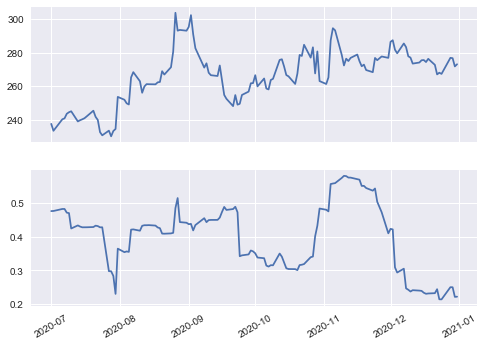

In [11]:
start = '2020-07-01'
end = '2020-12-31'
columns = ['Close', '20d_vol']
df_ = df.loc[start:end, columns]
fig, axes = plt.subplots(2,1,sharex=True)
axes[0].plot(df_.index,df_.Close)
axes[1].plot(df_.index,df_['20d_vol'])
plt.xticks(rotation=30)
plt.show()

In [37]:
def download_and_plot_moving_vol(ticker, window=21, start=None, end=None):
    df = download(ticker)
    df['Return'] = df.Close / df.Close.shift(1) - 1
    df[f'{window}d_vol'] = df.Return.rolling(window).std()*np.sqrt(12*21)
    
    columns = ['Close', f'{window}d_vol']
    if (start is not None) and (end is not None):
        df_ = df.loc[start:end, columns]
    else:
        df_ = df.loc[:, columns]
        
    fig, axes = plt.subplots(2,1,sharex=True)
    axes[0].set_title(ticker)
    axes[0].plot(df_.index,df_.Close)
    axes[1].plot(df_.index,df_[f'{window}d_vol'])
    #axes[1].set_xticks(axes[1].get_xticks()[::10])
    plt.xticks(rotation=90)
    plt.show()

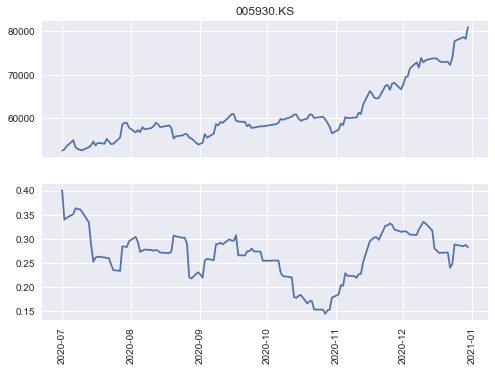

In [38]:
ticker = '005930.KS'
start = '2020-07-01'
end = '2020-12-31'
download_and_plot_moving_vol(ticker, window=21, start=start, end=end)

In [41]:
def read_and_plot_moving_vol(ticker, window=21, start=None, end=None):
    file_name = f'../data/sp500/{ticker}.csv'
    df = pd.read_csv(file_name, parse_dates=True)
    df = df.set_index('Date')
    df['Return'] = df.Close / df.Close.shift(1) - 1
    df[f'{window}d_vol'] = df.Return.rolling(window).std()*np.sqrt(12*21)
    
    columns = ['Close', f'{window}d_vol']
    if (start is not None) and (end is not None):
        df_ = df.loc[start:end, columns]
    else:
        df_ = df.loc[:, columns]
        
    fig, axes = plt.subplots(2,1,sharex=True)
    axes[0].set_title(ticker)
    axes[0].plot(df_.index,df_.Close)
    axes[1].plot(df_.index,df_[f'{window}d_vol'])
    axes[1].set_xticks(axes[1].get_xticks()[::10])
    plt.xticks(rotation=90)
    plt.show()

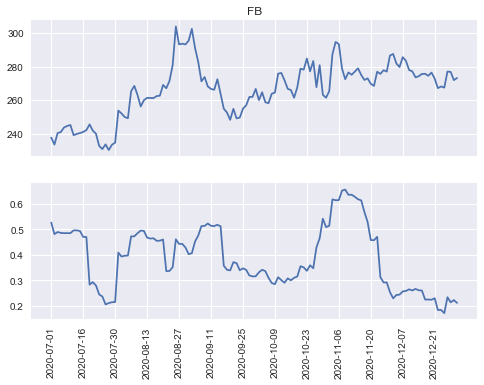

In [42]:
ticker = 'FB'
window = 5 * 3
start = '2020-07-01'
end = '2020-12-31'
read_and_plot_moving_vol(ticker, window=window, start=start, end=end)

In [33]:
url = 'https://raw.githubusercontent.com/datasets/s-and-p-500-companies/master/data/constituents.csv'
df_tickers = pd.read_csv(url)
df_tickers

,Symbol,Name,Sector
0,MMM,3M Company,Industrials
1,AOS,A.O. Smith Corp,Industrials
2,ABT,Abbott Laboratories,Health Care
3,ABBV,AbbVie Inc.,Health Care
4,ABMD,ABIOMED Inc,Health Care
...,...,...,...
500,YUM,Yum! Brands Inc,Consumer Discretionary
501,ZBRA,Zebra Technologies,Information Technology
502,ZBH,Zimmer Biomet Holdings,Health Care
503,ZION,Zions Bancorp,Financials


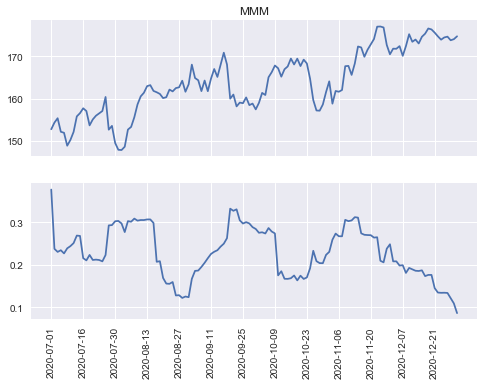

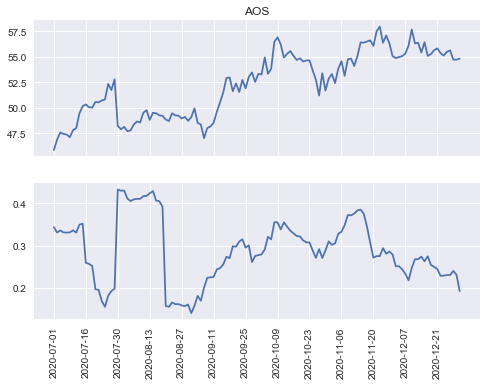

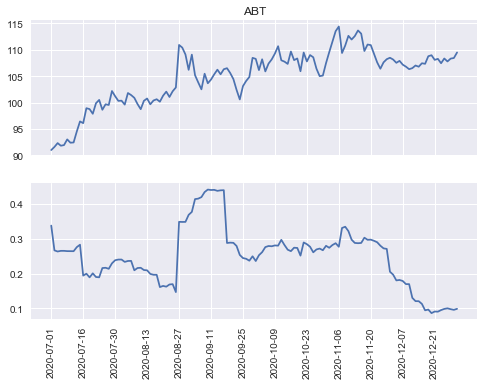

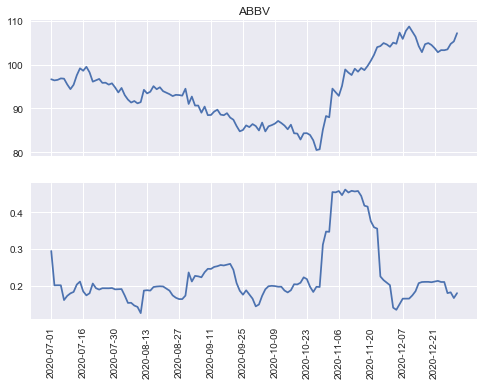

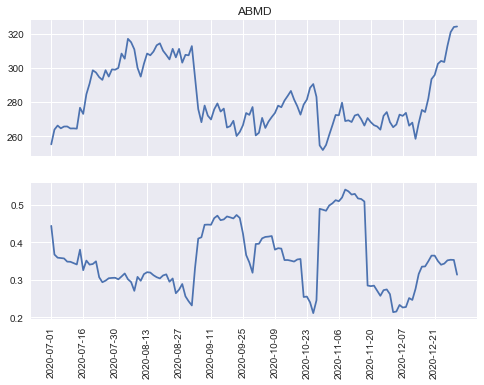

...

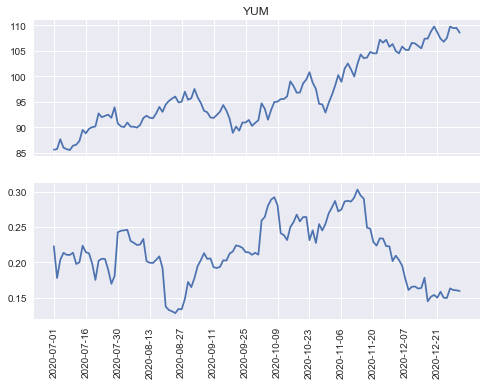

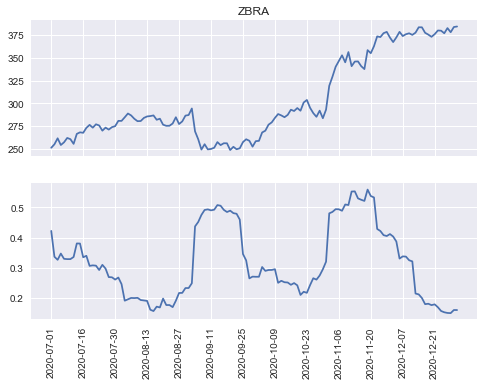

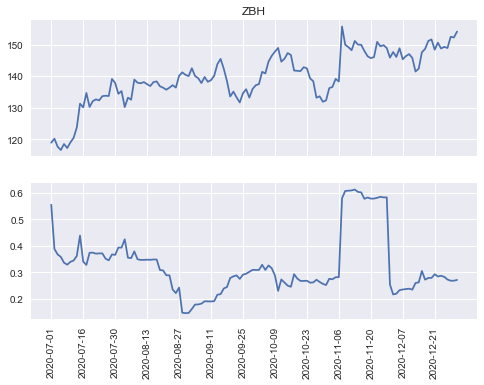

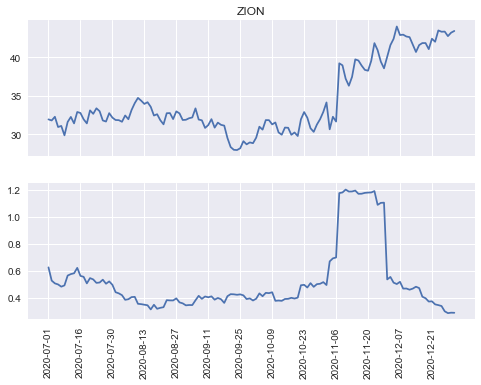

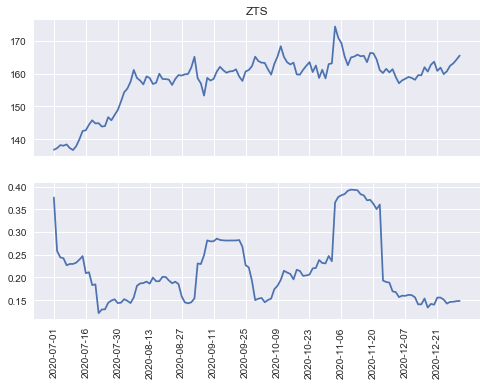

In [34]:
window = 5 * 3
start = '2020-07-01'
end = '2020-12-31'

for ticker in df_tickers.Symbol:
    if ticker=='BRK.B':
        ticker = 'BRK-B'
    if ticker=='BF.B':
        ticker = 'BF-B'
    read_and_plot_moving_vol(ticker, window=window, start=start, end=end)